# 1. Entendimiento del negocio

Una empresa de turismo quiere sugerir a sus asociados qué restaurante pueden vistiar en la zonda de playa de California con la información de las reseñas de los restaurantes realizadas por otros usuarios

# 2. Enfoque analítico

Construir un modelo de recomendación que pueda ser validado por el usuario

# 3. Requerimiento de datos

Se necesitan datos de las reseñas o calificaciones realizadas por lo susuraiors en los restaurantes

# 4. Recolección de datos

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import missingno as msno

import warnings
warnings.filterwarnings("ignore")

In [2]:
data = pd.read_csv("../Datasets/sb_restaurants_clean.csv")
data.drop(columns=["Unnamed: 0"], inplace=True)
data

,user_id,business_id,stars,name
0,IlWLPCRQp8iqX0X-ExQccQ,bdfZdB2MTXlT6-RBjSIpQg,4.0,Pho Bistro
1,WSMIRegvrsEgFGEraf_LwQ,bdfZdB2MTXlT6-RBjSIpQg,5.0,Pho Bistro
2,2odfcvFhkb8SedI3vCLpmQ,bdfZdB2MTXlT6-RBjSIpQg,5.0,Pho Bistro
3,OEKu0Rts0spELpbnucDKmA,bdfZdB2MTXlT6-RBjSIpQg,5.0,Pho Bistro
4,4MSEWnnxKhNdh7GgNHM-YQ,bdfZdB2MTXlT6-RBjSIpQg,4.0,Pho Bistro
...,...,...,...,...
37825,pc3rsR3ji6na9OKucyXRuw,nhOMsw22-rz9kXSKwBZYAQ,2.0,Miracle At The Funk Zone
37826,LuPUwdJMWqahkSIb8SrI9w,nhOMsw22-rz9kXSKwBZYAQ,2.0,Miracle At The Funk Zone
37827,iubWB0-vNBWR3E_ZPeKPjA,nhOMsw22-rz9kXSKwBZYAQ,4.0,Miracle At The Funk Zone
37828,A4bsa7ykYRVCnb4h2vZALw,nhOMsw22-rz9kXSKwBZYAQ,5.0,Miracle At The Funk Zone


# 5. Exploración de los Datos

- Nulidad de los datos
- Cantidad de registros por elementos
- Exploración de las calificaciones

## Datos Nulos

<Axes: >

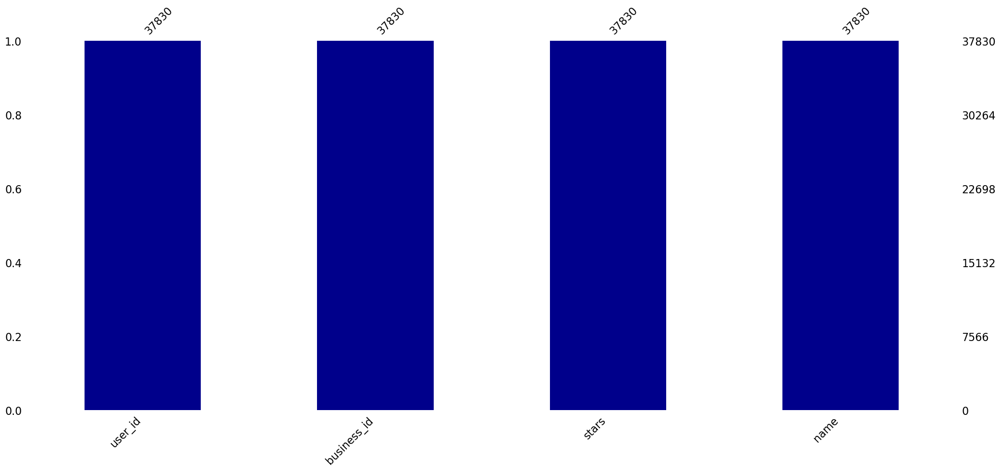

In [3]:
msno.bar(data, color="darkblue")

## Cantidad de Registros

In [4]:
num_restaurants = data['name'].nunique()
num_users = data['user_id'].nunique()
num_reviews = data['stars'].count()

print(f'Número de restaurantes únicos: {num_restaurants}')
print(f'Número de usuarios únicos: {num_users}')
print(f'Número de reseñas: {num_reviews}')

Número de restaurantes únicos: 659
Número de usuarios únicos: 23468
Número de reseñas: 37830


## Exploración de las Calificaciones

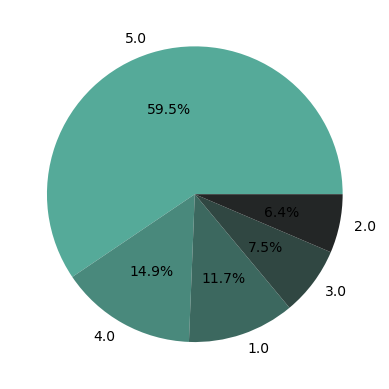

In [5]:
plt.pie(data['stars'].value_counts(), labels=data['stars'].value_counts().index, autopct='%1.1f%%', colors=sns.color_palette('dark:#5A9_r', n_colors=len(data['stars'].value_counts())))
plt.show()

# 6. Modelo

- Crear la matriz pivote
- Reducción de dimensionalidad
- Contruir las matrices de similitud para la recomendación

## Matriz pivote

In [6]:
user_restaurant = data.pivot_table(values='stars', index='name', columns='user_id')
user_restaurant.fillna(0, inplace=True)
user_restaurant

user_id,---zemaUC8WeJeWKqS6p9Q,--2F5G5LKt3h2cAXJbZptg,--7XOV5T9yZR5w1DIy_Dog,--8YG4BoOWFGjdh9Fxop-w,--_QWYpJ2In2IgW_bouSuQ,--kinfHwmtdjz03g8B8z8Q,-0-Cbo-4YzKmoJXpnckwbg,-0-TtVhV4PIUoDpUCOC0uQ,-06H6BQ5cS5A5Jpd_iiwCA,-09MjuD1Q0KwSYwdYbAzMw,...,zyP0-AxYAb61wVroBgR0ng,zyQcIz_DR9CM-Tah3B7Tfw,zyWX5BNC9JhEsrrzaK-X9g,zyakHeX-9wVqU33jn6NMtA,zym3VpXHS4YWRMXUJ-MxsQ,zyvAj-SNHqHnrTN0X5_adA,zyzSePGcKiiA15e1takl4g,zzkJpm2B4PNPHnXg-CMyog,zzudZ50i88aStmQ6Ft1cVA,zzzGgfvrSJ4AQeKtcgocIw
name,,,,,,,,,,,,,,,,,,,,,
101 Deli,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1114 Sports Bar & Games,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4 Eggs & Pizza,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
A Slice of Woodstock's,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AH Juice Organics,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Zaytoon,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Zen Yai Thai Cuisine,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Zizzo's Coffeehouse,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## Reducción de dimensionalidad

In [7]:
from sklearn.decomposition import TruncatedSVD

In [8]:
SVD = TruncatedSVD(n_components=659, random_state=42)
SVD.fit(user_restaurant)

TruncatedSVD(n_components=659, random_state=42)

In [9]:
num_sv = 5
print('La cantidad de información explicada con los primeros %d vectores singulares es: ' % num_sv)
print('%0.2f%%' % (100 * (1 - (SVD.singular_values_[0:num_sv].sum()/(SVD.singular_values_.sum())))))

La cantidad de información explicada con los primeros 5 vectores singulares es: 
96.87%


In [10]:
SVD_5 = TruncatedSVD(n_components=5, random_state=42)
result_matrix = SVD_5.fit_transform(user_restaurant)
result_matrix

array([[ 0.08325865,  0.0827159 ,  0.15625382,  0.03734063, -0.03711163],
       [ 2.22545948,  1.18559033,  0.81729322,  2.08507674, -0.9080326 ],
       [ 1.65760476,  0.62004894,  0.43417323,  1.29517647, -0.26026814],
       ...,
       [ 0.09117129,  0.02401858,  0.03505825,  0.06723986, -0.02856405],
       [ 1.88249287,  1.20883569,  1.13118453,  0.92939539, -0.46709159],
       [ 0.2850191 ,  0.08991918, -0.01642041,  0.06385593, -0.06107389]],
      shape=(659, 5))

## Matrices de similitud

In [11]:
from sklearn.metrics.pairwise import cosine_similarity

In [12]:
corrMtx = np.corrcoef(result_matrix)
corrSpMtx = pd.DataFrame(result_matrix.T).corr(method='spearman')
cosineMtx = cosine_similarity(result_matrix)

## Correlación de Pearson

In [13]:
corrMtx[0:5, 0:5]

array([[1.        , 0.48612014, 0.34456424, 0.86775303, 0.64899054],
       [0.48612014, 1.        , 0.96755048, 0.7913078 , 0.97006447],
       [0.34456424, 0.96755048, 1.        , 0.65070888, 0.89952492],
       [0.86775303, 0.7913078 , 0.65070888, 1.        , 0.86323812],
       [0.64899054, 0.97006447, 0.89952492, 0.86323812, 1.        ]])

In [14]:
liked = 'Taco Bell'
names = user_restaurant.T.columns
names_list = list(names)
id_liked = names_list.index(liked)
corr_recom_pearson = corrMtx[id_liked]
corr_recom_pearson[0 : 19]

array([ 0.2174252 ,  0.60299846,  0.73710169,  0.39440022,  0.48431101,
        0.48959878,  0.38728345,  0.32087249,  0.55873588,  0.67532528,
        0.69729223,  0.81099849, -0.26907898,  0.87821296,  0.38466729,
        0.80324533,  0.90206156,  0.81626612,  0.32671001])

In [15]:
corr_recom_pearson[id_liked]

np.float64(1.0)

### Restaurantes recomendados

In [16]:
ids = (corr_recom_pearson > 0.95) & (corr_recom_pearson < 0.99)
tmp = list()
for i in range(len(names[ids])):
    tmp.append((corr_recom_pearson[ids][i], (names[ids][i])))
sorted(tmp, key = lambda x : x[0], reverse=True)

[(np.float64(0.9810166772724502), 'The Spot'),
 (np.float64(0.9804296607202774), 'El Rincon Bohemio'),
 (np.float64(0.9803579700132034), 'Taqueria El Bajio'),
 (np.float64(0.9709444430453978), 'Gladden and Sons Produce'),
 (np.float64(0.968430895887056), 'The Daily Grind'),
 (np.float64(0.9658292385491845), 'Pressed'),
 (np.float64(0.9652135092893898), 'Fresco Cafe'),
 (np.float64(0.9638076056146029), 'Revolver'),
 (np.float64(0.9619481721566405), "Norton's Pastrami & Deli"),
 (np.float64(0.9590613859996241), 'Freebirds'),
 (np.float64(0.9588960452271302), 'Subway'),
 (np.float64(0.958300434495668), 'Zookers Cafe'),
 (np.float64(0.9576559742148824), "Jeannine's Bakery & Restaurant"),
 (np.float64(0.9573652106288288), 'Del Valle Grill'),
 (np.float64(0.9566537006813484), 'Panaderia Veronica'),
 (np.float64(0.956292560538728), 'Bristol Farms - Santa Barbara'),
 (np.float64(0.9560523694457473), 'Habit Burger Grill'),
 (np.float64(0.9528886415061865), 'Starbucks'),
 (np.float64(0.952033900

## Correlación de Spearman

In [17]:
corrSpMtx

,0,1,2,3,4,5,6,7,8,9,...,649,650,651,652,653,654,655,656,657,658
0,1.0,0.3,0.3,0.7,0.3,-0.2,0.1,0.1,0.1,0.3,...,0.3,0.4,0.5,-0.7,0.6,0.3,0.3,0.5,0.7,0.4
1,0.3,1.0,1.0,0.2,0.8,0.3,0.9,0.9,0.9,1.0,...,1.0,0.9,0.9,0.2,0.4,1.0,1.0,0.9,0.7,0.9
2,0.3,1.0,1.0,0.2,0.8,0.3,0.9,0.9,0.9,1.0,...,1.0,0.9,0.9,0.2,0.4,1.0,1.0,0.9,0.7,0.9
3,0.7,0.2,0.2,1.0,0.0,0.3,0.1,0.1,0.1,0.2,...,0.2,0.5,0.1,-0.2,0.6,0.2,0.2,0.1,0.7,0.5
4,0.3,0.8,0.8,0.0,1.0,-0.3,0.9,0.9,0.9,0.8,...,0.8,0.5,0.9,0.2,-0.1,0.8,0.8,0.9,0.3,0.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
654,0.3,1.0,1.0,0.2,0.8,0.3,0.9,0.9,0.9,1.0,...,1.0,0.9,0.9,0.2,0.4,1.0,1.0,0.9,0.7,0.9
655,0.3,1.0,1.0,0.2,0.8,0.3,0.9,0.9,0.9,1.0,...,1.0,0.9,0.9,0.2,0.4,1.0,1.0,0.9,0.7,0.9
656,0.5,0.9,0.9,0.1,0.9,-0.1,0.8,0.8,0.8,0.9,...,0.9,0.7,1.0,-0.1,0.3,0.9,0.9,1.0,0.6,0.7
657,0.7,0.7,0.7,0.7,0.3,0.5,0.4,0.4,0.4,0.7,...,0.7,0.9,0.6,-0.3,0.9,0.7,0.7,0.6,1.0,0.9


In [18]:
liked = 'Taco Bell'
names = user_restaurant.T.columns
names_list = list(names)
id_liked = names_list.index(liked)
corr_recom_spearman = corrSpMtx[id_liked]
corr_recom_spearman[0 : 19]

0     0.4
1     0.9
2     0.9
3     0.5
4     0.5
5     0.6
6     0.7
7     0.7
8     0.7
9     0.9
10    0.9
11    0.3
12   -0.3
13    0.9
14    0.7
15    0.9
16    1.0
17    0.6
18    0.7
Name: 543, dtype: float64

In [19]:
corr_recom_spearman[id_liked]

np.float64(1.0)

In [20]:
sorted(corr_recom_spearman, reverse=True)

[1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9,
 0.9

### Resultados restaurantes

- La correlación de spearman hace una separación por rangos, se selecciona > 0.99 porque los valores mayores a 0.95 se aproximan a 1 para la recomendación

In [21]:
ids = (corr_recom_spearman > 0.99) & (corr_recom_spearman.index != liked)
tmp = list()
for i in range(len(names[ids])):
    tmp.append(((names[ids][i])))
sorted(tmp, key = lambda x : x[0])

['Angel Oak',
 'Backyard Bowls',
 'Blue Corn Tacos Catering',
 'Breakwater Restaurant',
 "Cantwell's Market & Deli",
 'Ca’Dario - Montecito',
 'China Palace',
 "Cody's Cafe",
 'Corazon Cocina',
 'Crush Bar and Tap',
 'Daily Greenz',
 'Dank Bowl Kitchen',
 "Dargan's Irish Pub & Restaurant",
 'Del Pueblo Cafe',
 "Derf's Cafe",
 'Dutch Garden Restaurant',
 'El Pastorcito',
 "Esau's Cafe",
 'Farmer Boy',
 'Freebirds',
 'Golden Line Coffee Bar',
 'Hana Kitchen',
 "Harry's Plaza Cafe",
 'Ike’s Love & Sandwiches',
 'Indo-China Market',
 'Institution Ale Company',
 "Jay C's Place",
 'KFC',
 'Kahuna Grill',
 'Kanaloa Seafood',
 'La Super-Rica Taqueria',
 'Lighthouse Coffee',
 "Lovejoy's Pickle Room",
 'MIZZA',
 'Mandarin Palace',
 'Masala Spice Indian Cuisine',
 'Night Lizard Brewing Company',
 "Norton's Pastrami & Deli",
 'Opal Restaurant & Bar',
 'Pascucci',
 "Pepe's Mexican Restaurant",
 'PokeCeviche',
 'Revolver',
 'Rincon Beach Bar',
 'Rockfire Grill',
 'Roof Top Bistro & Bar',
 'Shoreline

## Similitud de Coseno

In [26]:
cosineMtx

array([[1.        , 0.73934967, 0.69186636, ..., 0.7402953 , 0.88386252,
        0.52647045],
       [0.73934967, 1.        , 0.98153018, ..., 0.98149603, 0.93983222,
        0.84044684],
       [0.69186636, 0.98153018, 1.        , ..., 0.98552998, 0.93084637,
        0.8821884 ],
       ...,
       [0.7402953 , 0.98149603, 0.98552998, ..., 1.        , 0.93697745,
        0.86621426],
       [0.88386252, 0.93983222, 0.93084637, ..., 0.93697745, 1.        ,
        0.8435665 ],
       [0.52647045, 0.84044684, 0.8821884 , ..., 0.86621426, 0.8435665 ,
        1.        ]], shape=(659, 659))

In [22]:
cosineMtx[0:5, 0:5]

array([[1.00000000e+00, 7.39349672e-01, 6.91866360e-01, 6.59939164e-23,
        8.14126313e-01],
       [7.39349672e-01, 1.00000000e+00, 9.81530178e-01, 5.88118719e-23,
        9.83227870e-01],
       [6.91866360e-01, 9.81530178e-01, 1.00000000e+00, 1.63257401e-23,
        9.43752039e-01],
       [6.59939164e-23, 5.88118719e-23, 1.63257401e-23, 8.50778900e-44,
        8.13154189e-23],
       [8.14126313e-01, 9.83227870e-01, 9.43752039e-01, 8.13154189e-23,
        1.00000000e+00]])

In [23]:
liked = 'Taco Bell'
names = user_restaurant.T.columns
names_list = list(names)
id_liked = names_list.index(liked)
corr_recom = cosineMtx[id_liked]
corr_recom[0 : 19]

array([ 6.96221600e-01,  8.16545863e-01,  8.90008206e-01, -6.34431473e-23,
        7.57404006e-01,  3.25404986e-01,  7.91697032e-01,  6.31191628e-01,
        8.07259892e-01,  7.69999145e-01,  9.05384026e-01,  4.41035772e-01,
        2.87685826e-20,  9.28062446e-01,  7.76974853e-01,  9.24419679e-01,
        8.64318765e-01,  8.75506014e-01,  8.29990251e-01])

In [24]:
corr_recom[id_liked]

np.float64(1.0)

### Restaurantes recomendados

In [25]:
ids = (corr_recom > 0.95) & (corr_recom < 0.99)
tmp = list()
for i in range(len(names[ids])):
    tmp.append((corr_recom[ids][i], (names[ids][i])))
sorted(tmp, key = lambda x : x[0], reverse=True)

[(np.float64(0.9896674166203578), 'Habit Burger Grill'),
 (np.float64(0.989319362396484), 'Subway'),
 (np.float64(0.9887885405304315), 'El Rincon Bohemio'),
 (np.float64(0.9885362266523479), 'The Spot'),
 (np.float64(0.9831007569392579), "Z's - Taphouse & Grill"),
 (np.float64(0.9827165290445582), 'Revolver'),
 (np.float64(0.9822383074277922), "Bree'osh"),
 (np.float64(0.977852825965074), 'Ca’Dario - Montecito'),
 (np.float64(0.9777154257338198), 'Sushi GoGo'),
 (np.float64(0.9760836078140191), "Rusty's Pizza Parlor"),
 (np.float64(0.9758962776463568), "Mulligan's Cafe & Bar"),
 (np.float64(0.9751119635105734), 'Kanaloa Seafood'),
 (np.float64(0.9727829884668115), "Wendy's"),
 (np.float64(0.9711802999381588), 'Hibachi Steak House & Sushi Bar'),
 (np.float64(0.9710902302744495), 'Corazon Cocina'),
 (np.float64(0.9707856908528452), 'Finch & Fork'),
 (np.float64(0.9701793885058689), "Super Cuca's Taqueria"),
 (np.float64(0.9695797609097935), 'The Drunken Crab'),
 (np.float64(0.96795632800